In [1]:
import os
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

ROOT_DIR = os.path.abspath("../")

### Showing Images ###

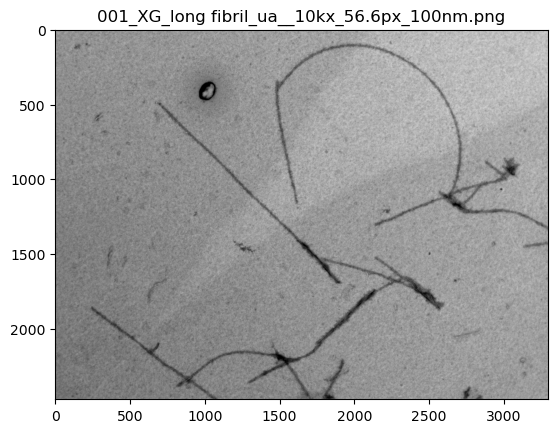

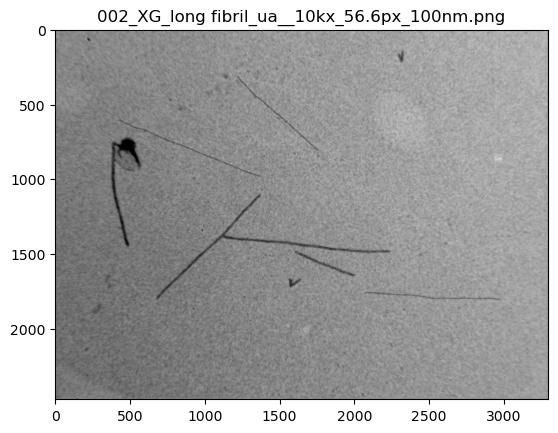

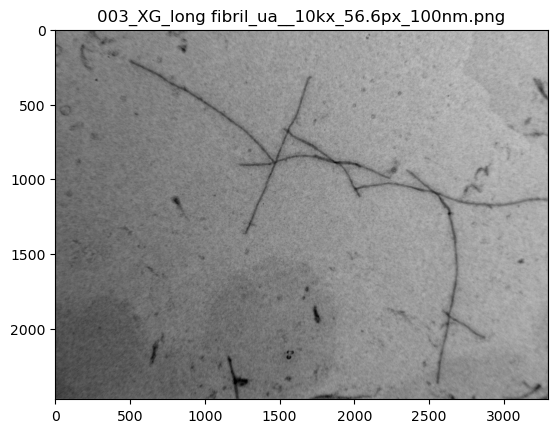

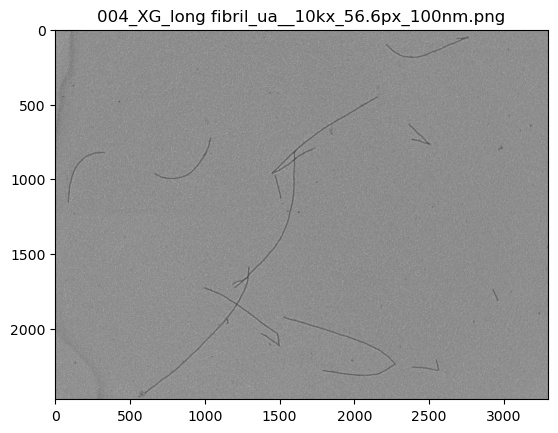

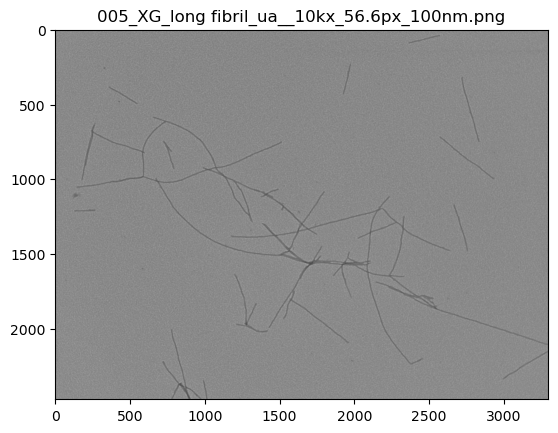

...

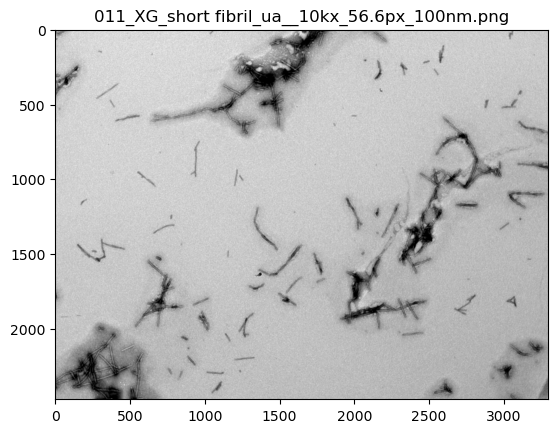

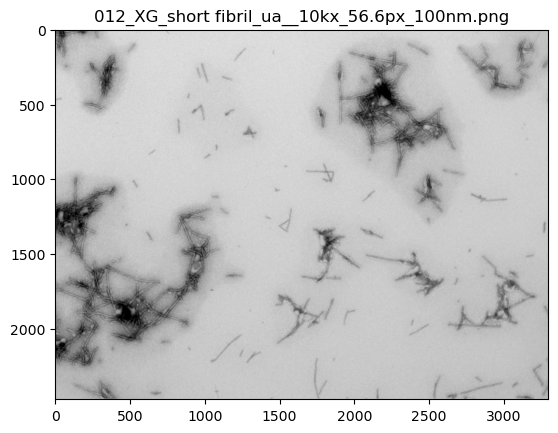

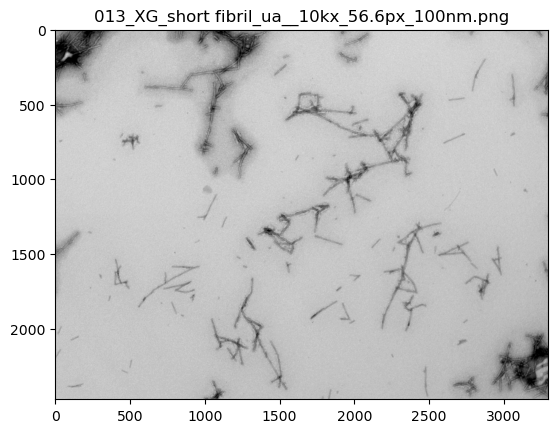

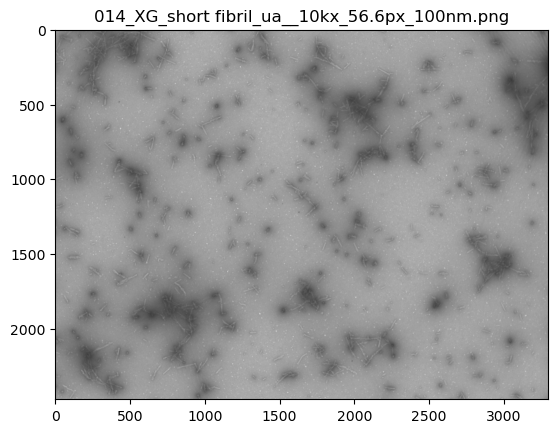

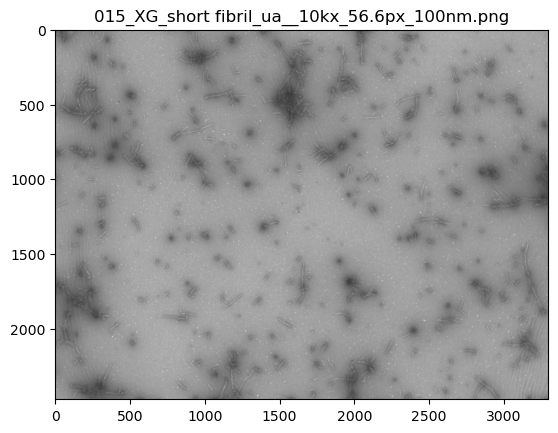

In [2]:
IMG_DIR = os.path.join(ROOT_DIR, "data/annotated data sets/set 1/png files/")

images = []
for imname in sorted(os.listdir(IMG_DIR), key=lambda x: x[:3]):
    if not imname.endswith(".png"):
        continue
    
    impath = os.path.join(IMG_DIR, imname)
    
    img = cv.imread(impath, cv.IMREAD_UNCHANGED).astype(np.float64)
    images.append(img)

    plt.imshow(img, cmap='gray', vmin=0.0, vmax=255.0)
    plt.title(imname)
    plt.show()

### Fourier Transforms ###

In [3]:
def plot_images(imgs, modified, modified_title='Modified Image', title='Image vs Modified', original_title='Original Image'):
    for im, md in zip(imgs, modified):
        f, arr = plt.subplots(1, 2, figsize=(12, 6), layout='compressed')
        if len(im.shape) == 2:
            ax1 = arr[0].imshow(im, cmap='gray', vmin=0.0, vmax=255.0)
        else:
            ax1 = arr[0].imshow(im)
        if len(md.shape) == 2:
            ax2 = arr[1].imshow(md, cmap='gray', vmin=md.min(), vmax=md.max())
        else:
            ax2 = arr[1].imshow(md)
        arr[0].set_title(original_title)
        arr[1].set_title(modified_title)
        if len(im.shape) == 2:
            plt.colorbar(ax1, ax=arr[0], aspect=30, orientation='horizontal', fraction=0.038)
        if len(md.shape) == 2:
            plt.colorbar(ax2, ax=arr[1], aspect=30, orientation='horizontal', fraction=0.038)
        f.suptitle(title)
        plt.show()

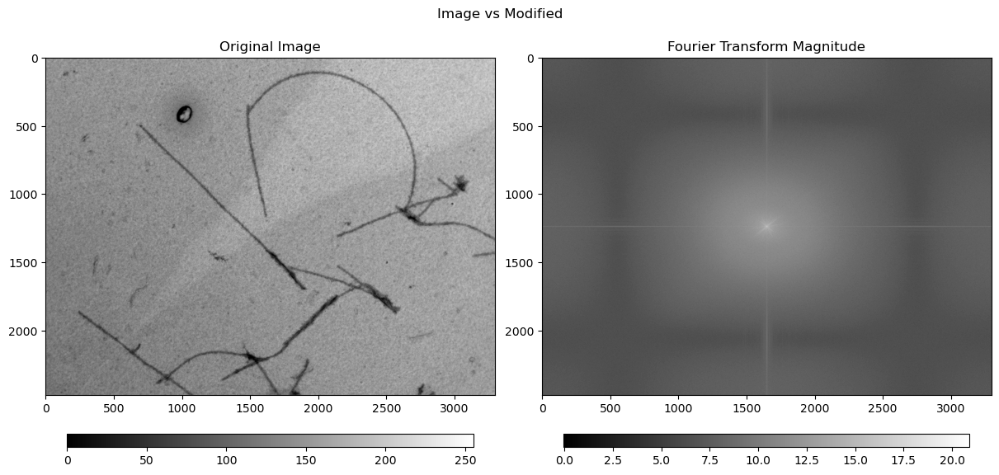

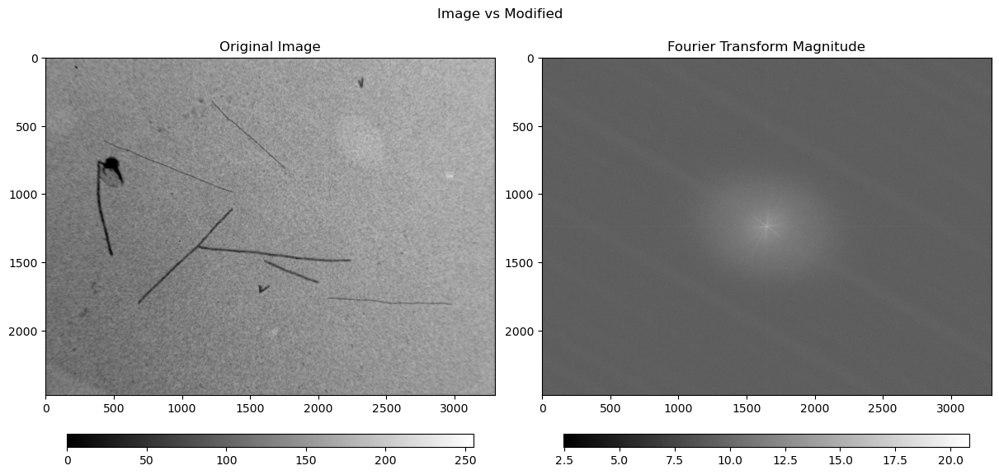

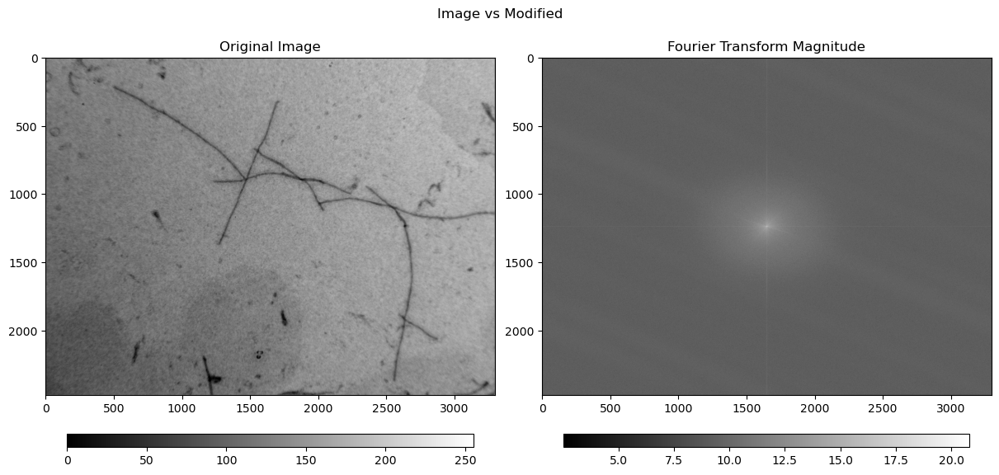

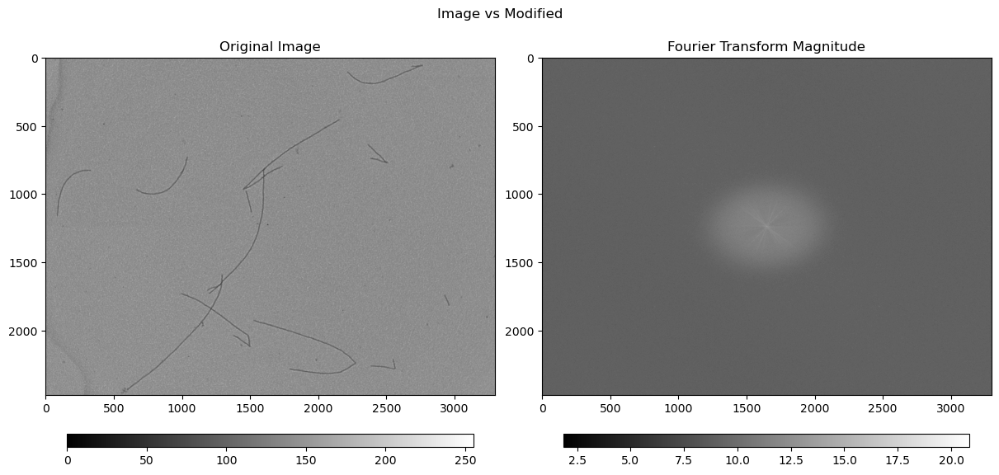

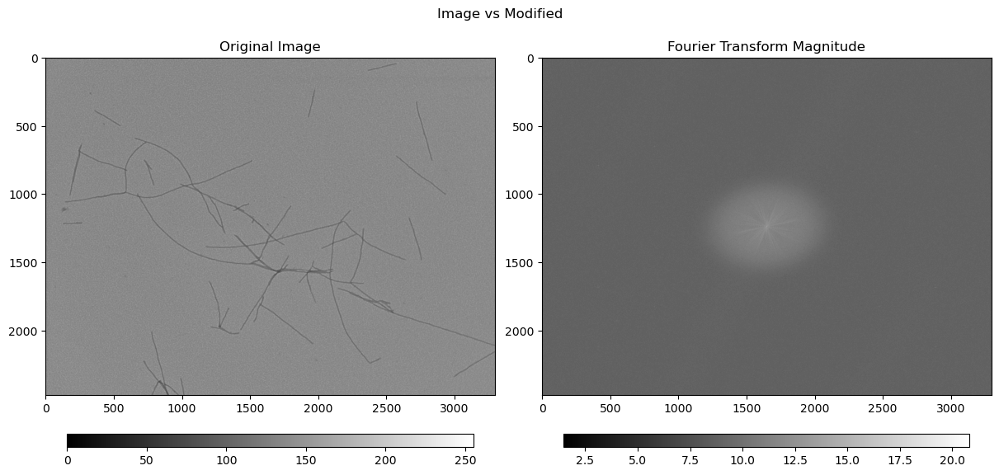

...

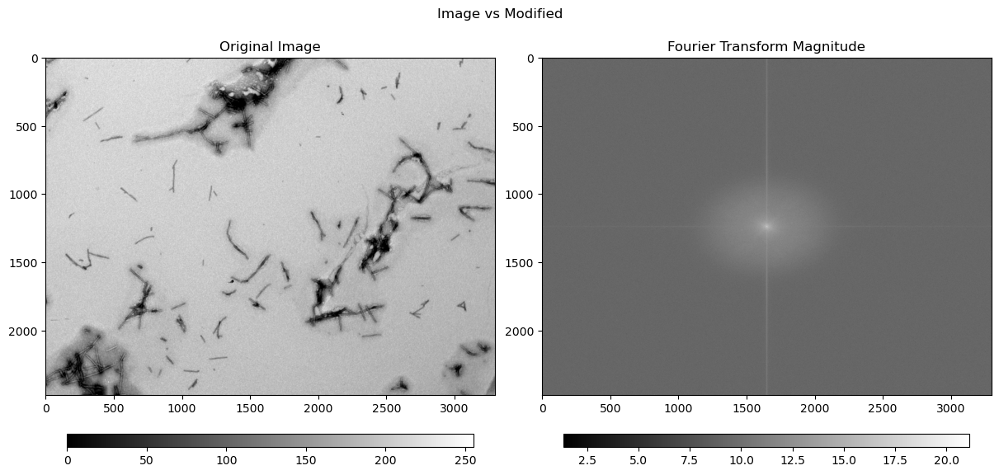

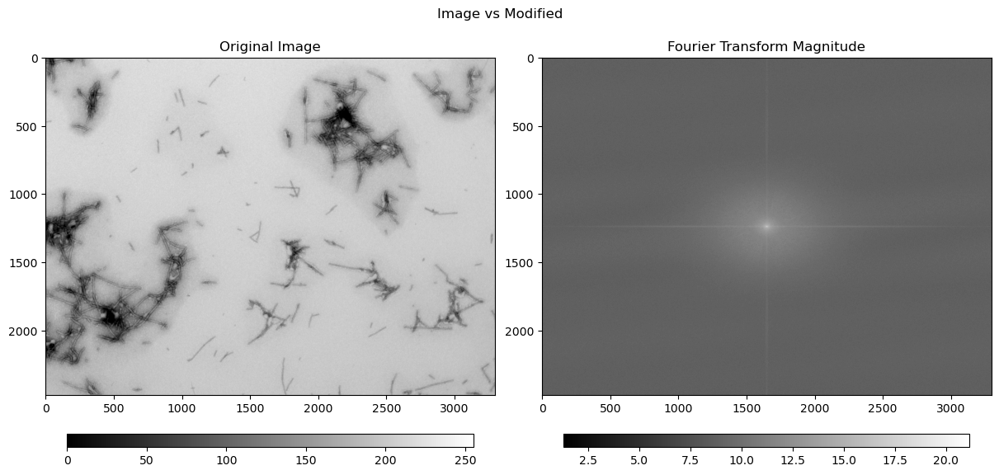

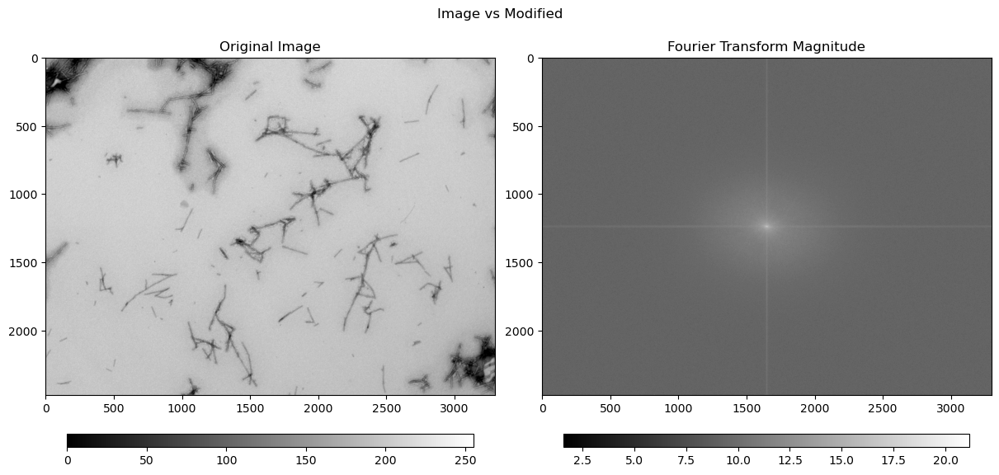

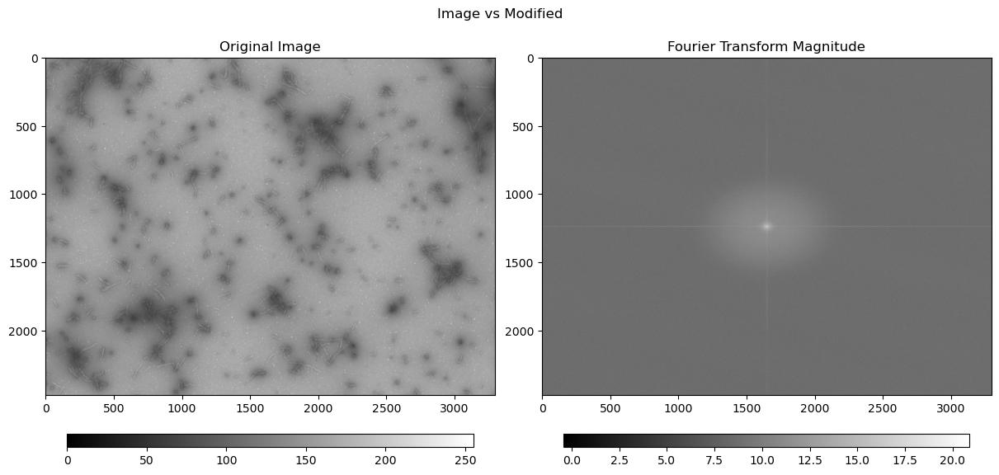

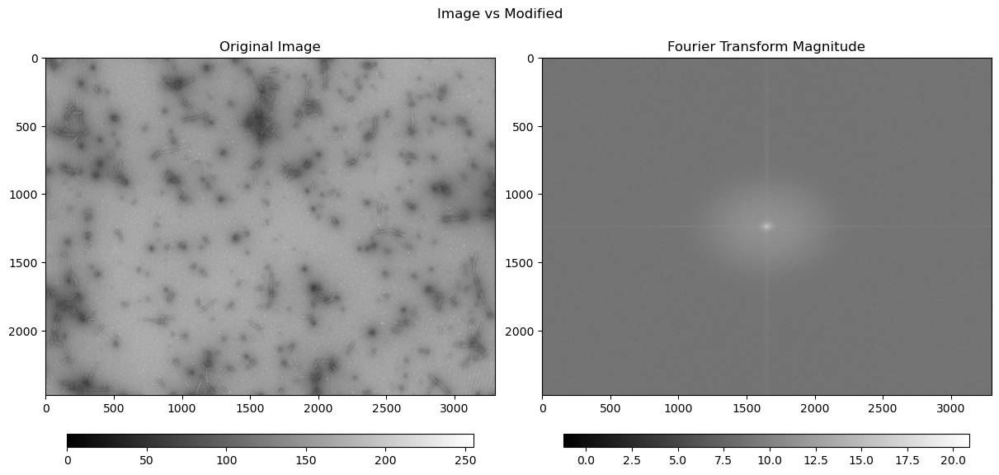

In [4]:
f_powers = []
ffts = []
for img in images:
    f = np.fft.fftshift(np.fft.fft2(img))
    ffts.append(f)
    f_powers.append(np.log(np.abs(f)))

plot_images(images, f_powers, 'Fourier Transform Magnitude') 

In [5]:
def create_frequency_masks(shape, low_radius, high_radius):
    rows, cols = shape
    ratio = rows / cols
    cy, cx = rows // 2, cols // 2
    y, x = np.ogrid[:rows, :cols]
    dist = np.sqrt(((x - cx)**2)*ratio + ((y - cy)**2)/ratio)

    low_freq_mask = dist <= low_radius
    high_freq_mask = dist >= high_radius

    return low_freq_mask, high_freq_mask

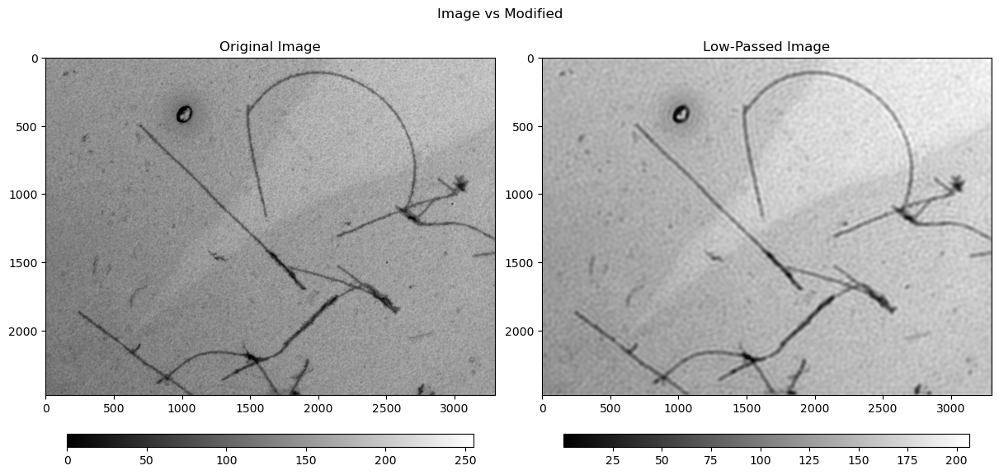

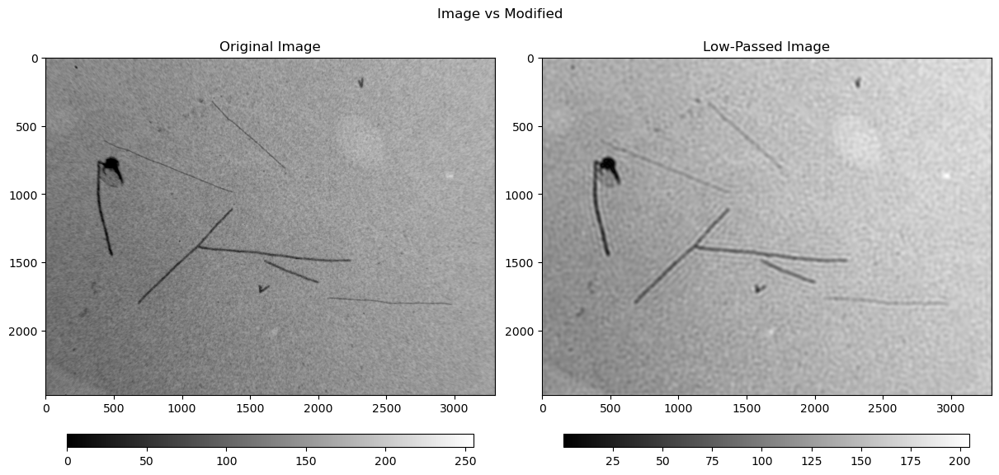

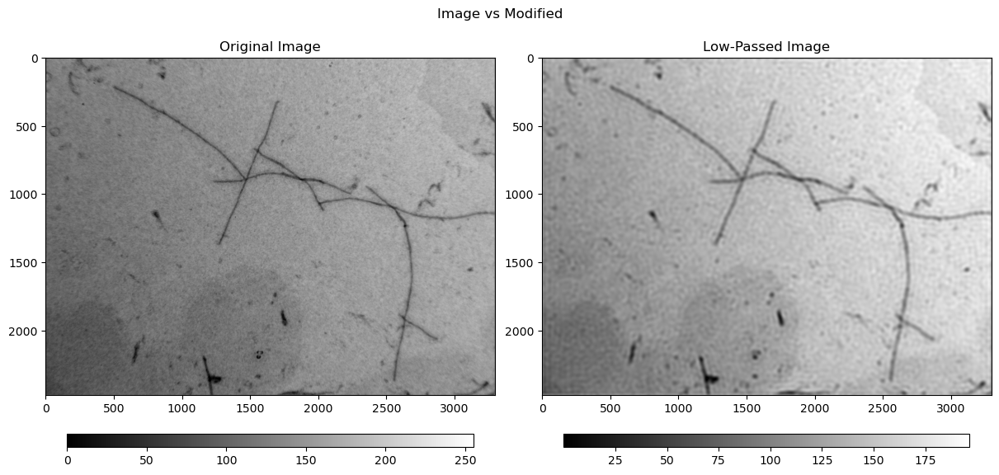

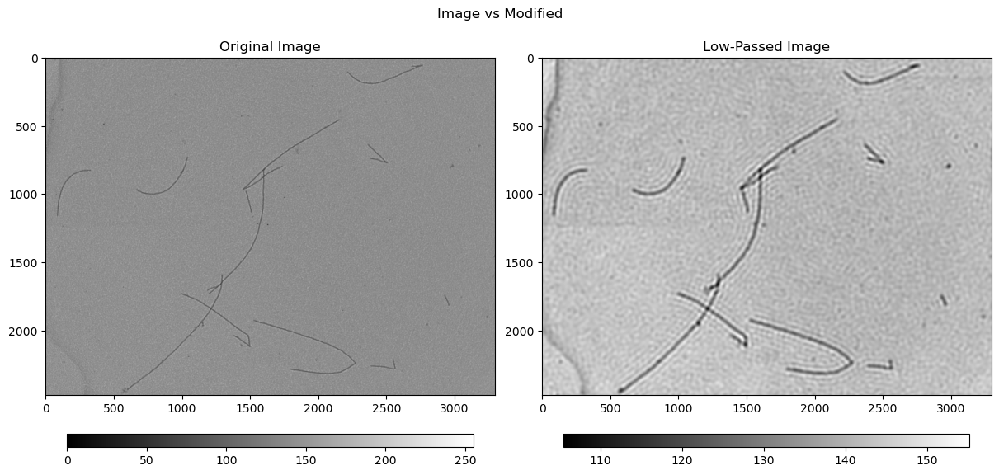

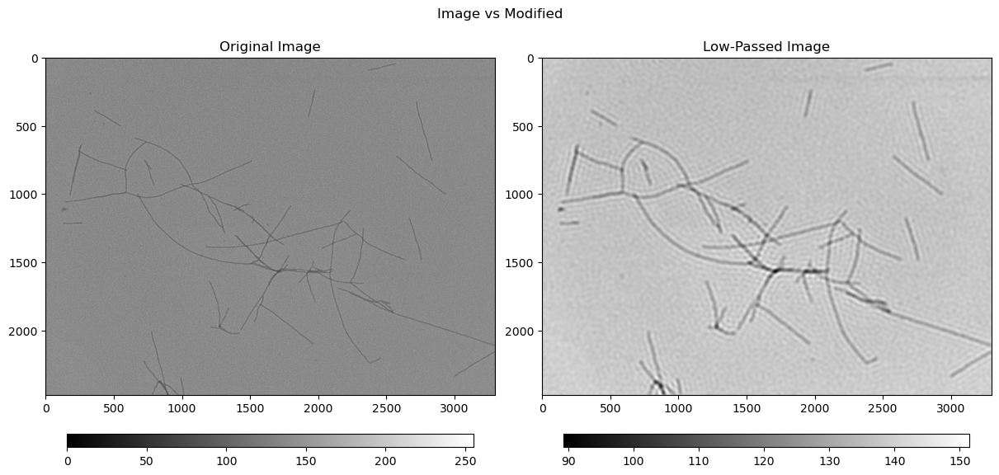

...

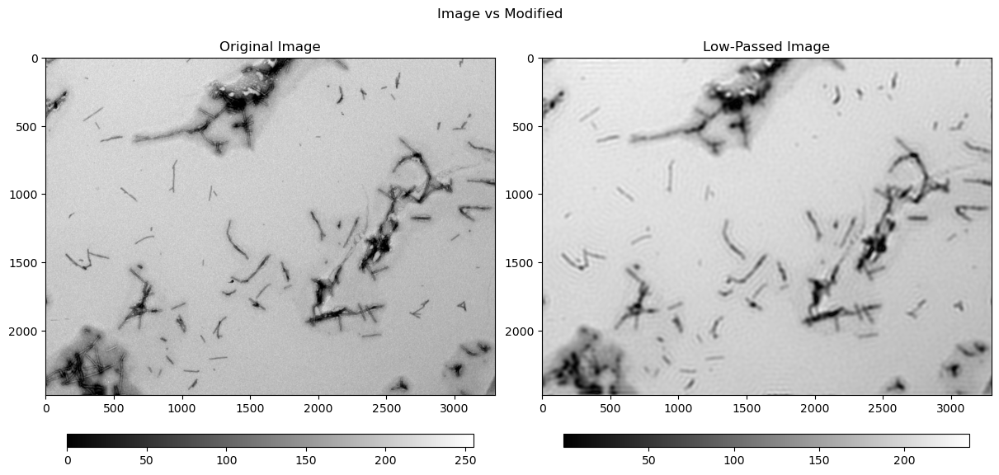

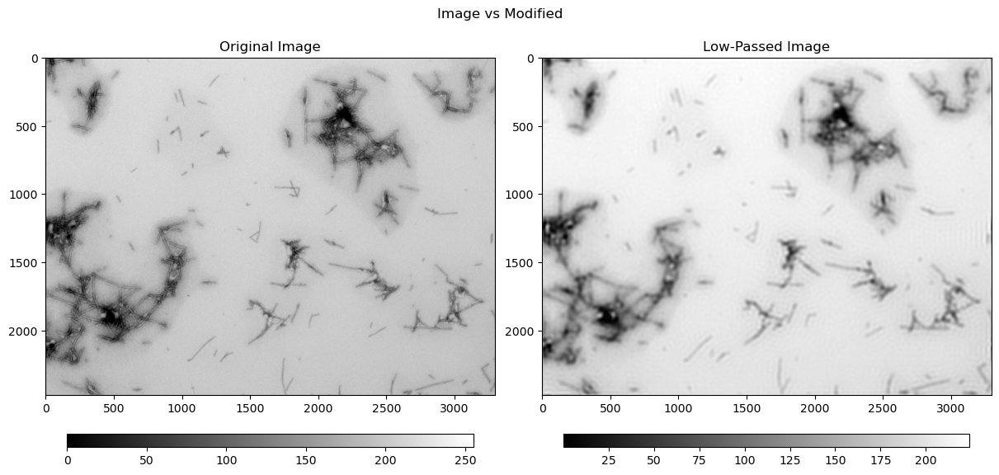

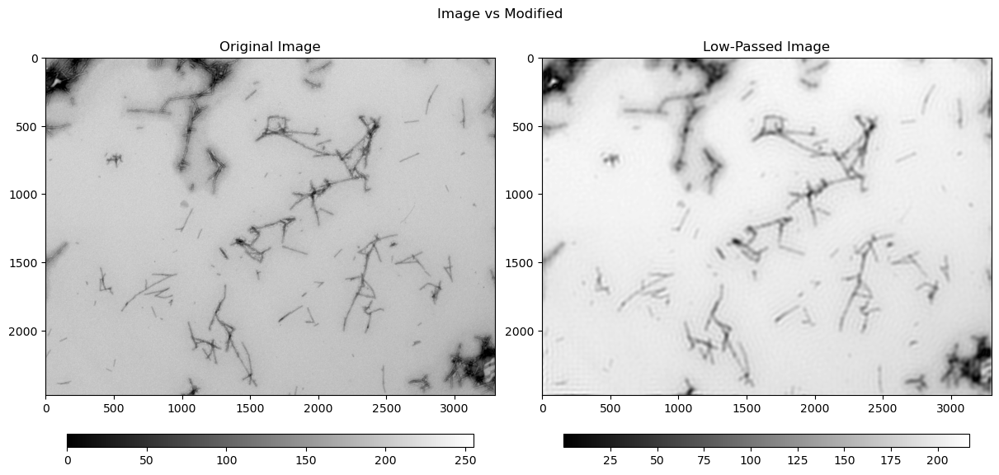

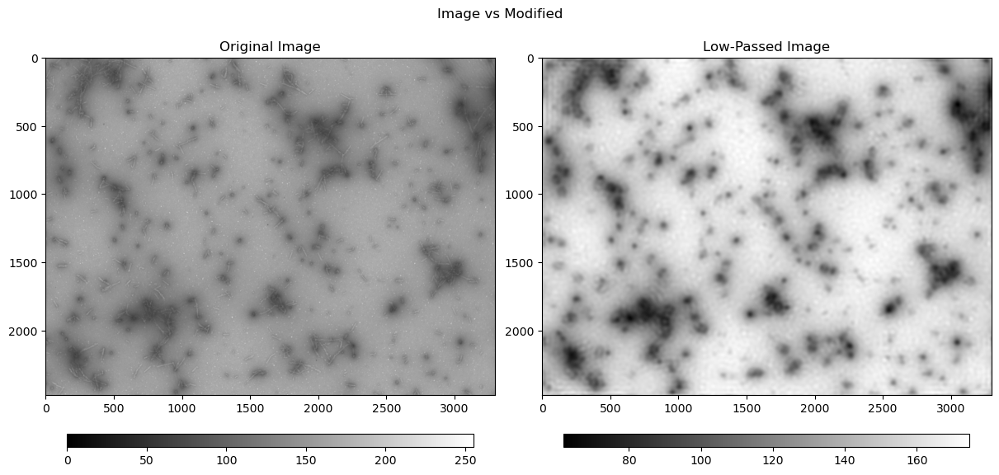

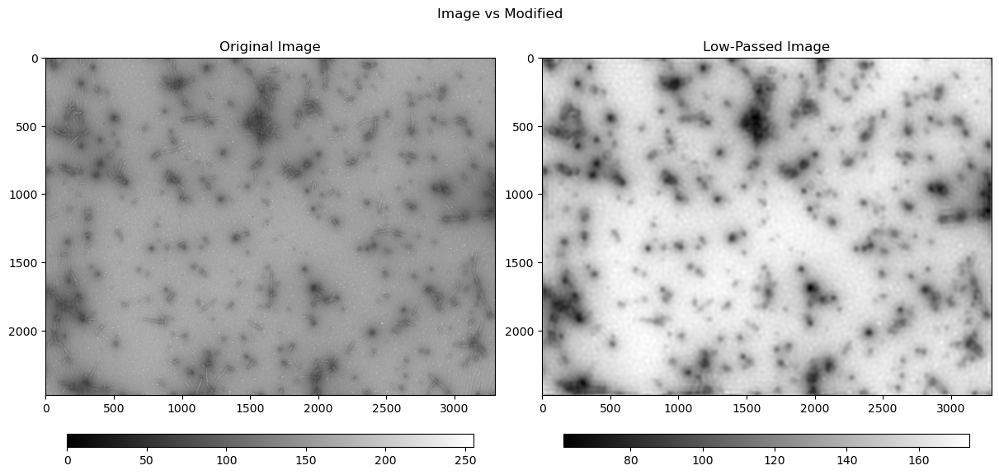

In [6]:
low_pass_images = []
for fft in ffts:
    low_pass, _ = create_frequency_masks(fft.shape, 75, 4000)
    filtered = np.abs(np.fft.ifft2(np.fft.ifftshift(fft * low_pass)))
    low_pass_images.append(filtered)
    

plot_images(images, low_pass_images, 'Low-Passed Image')

### Color Distribution Histograms ###

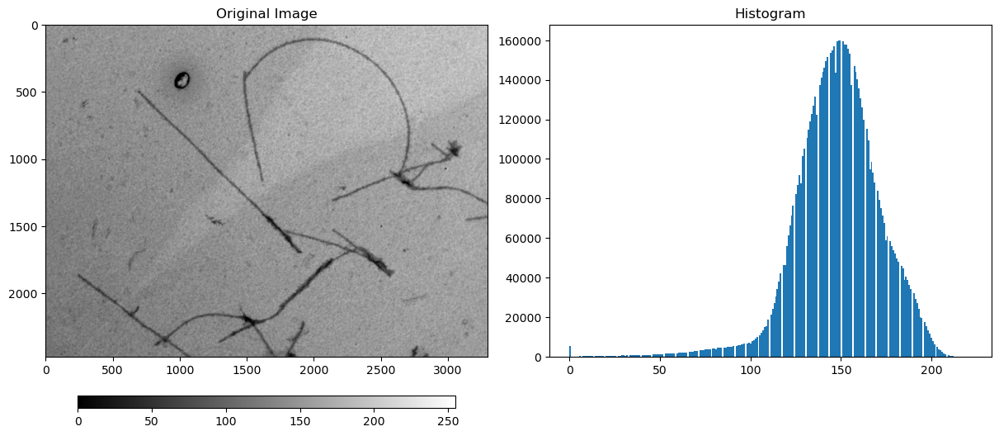

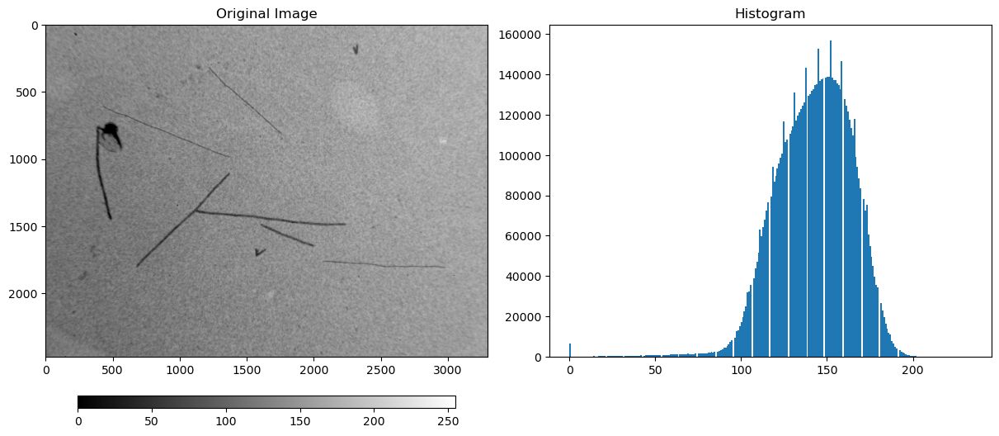

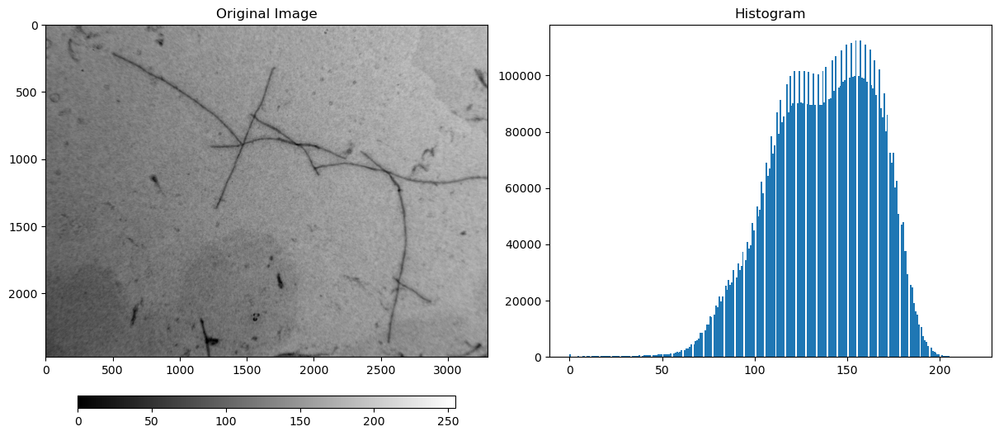

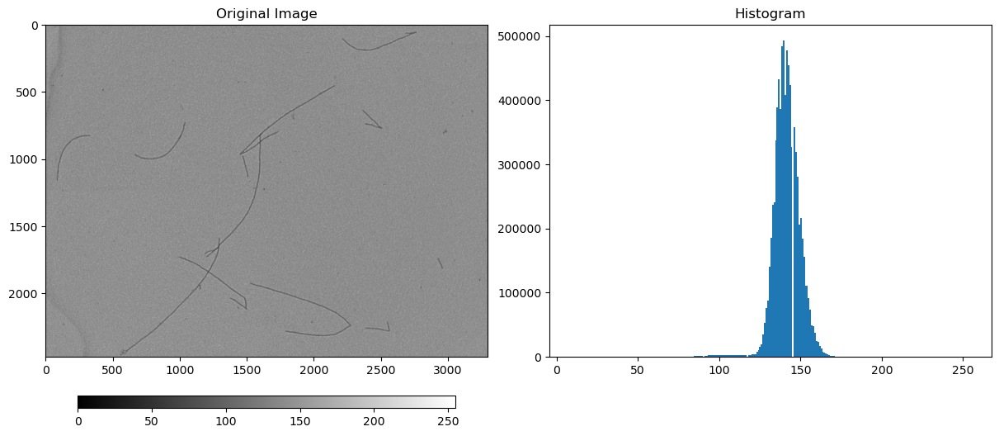

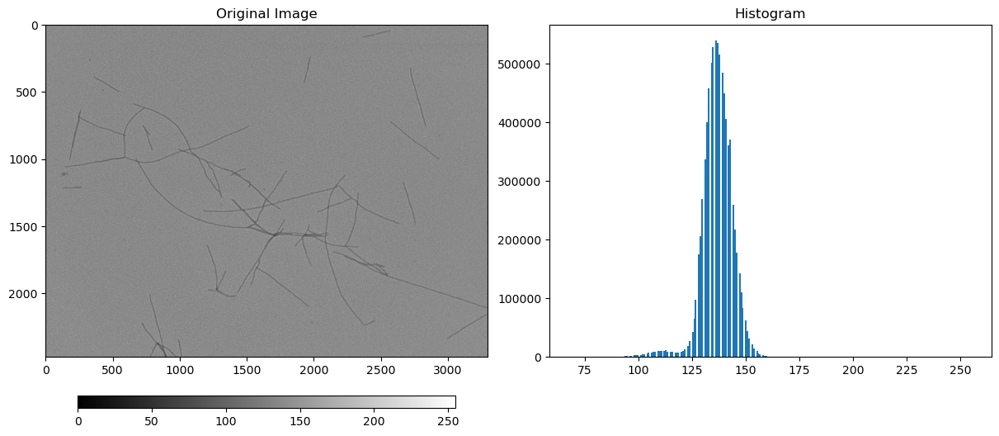

...

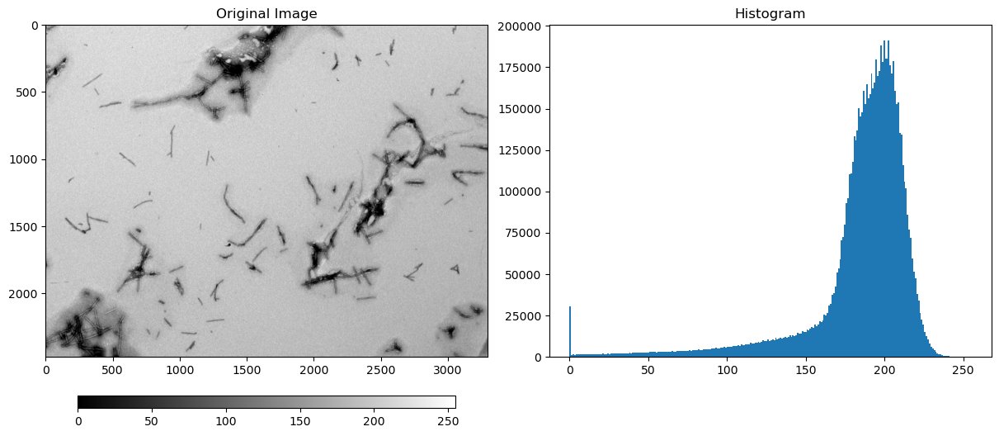

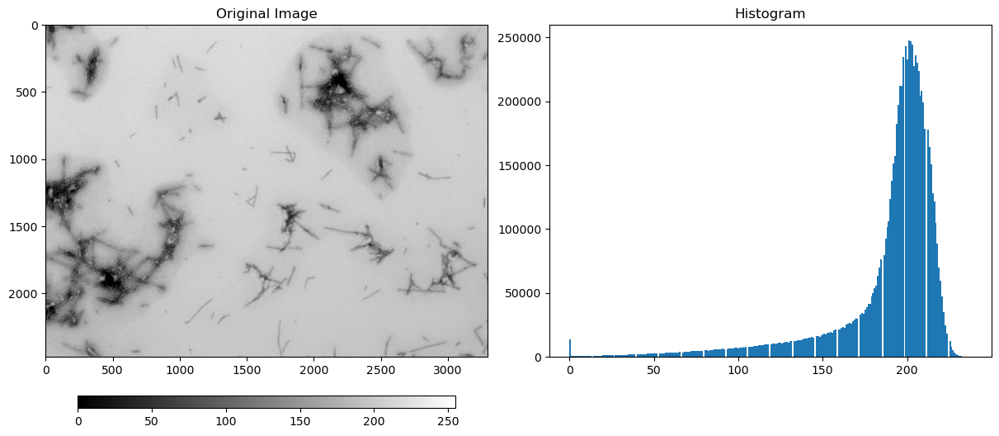

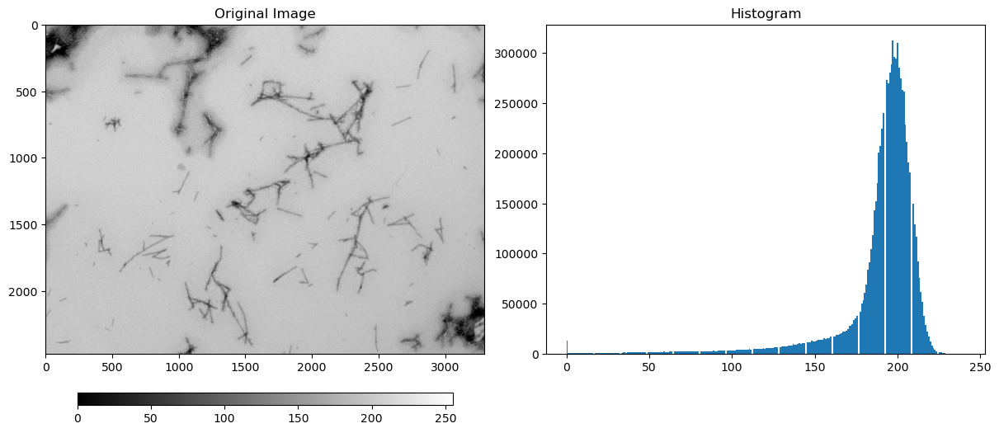

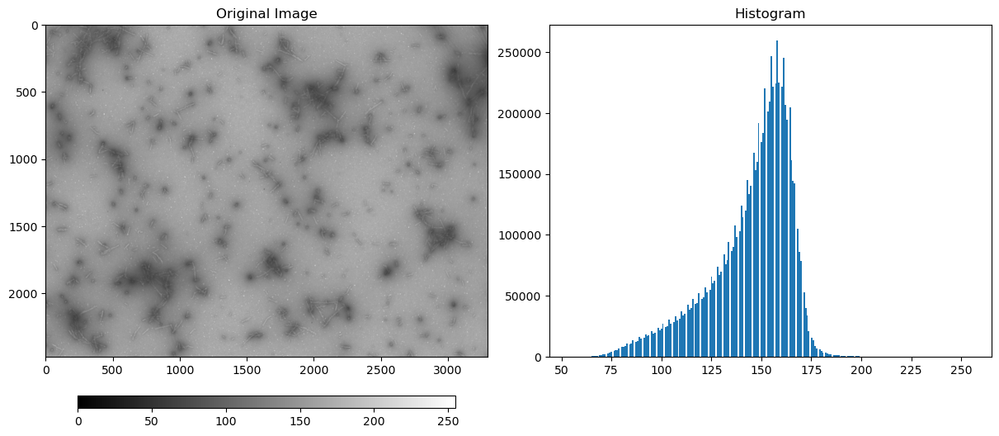

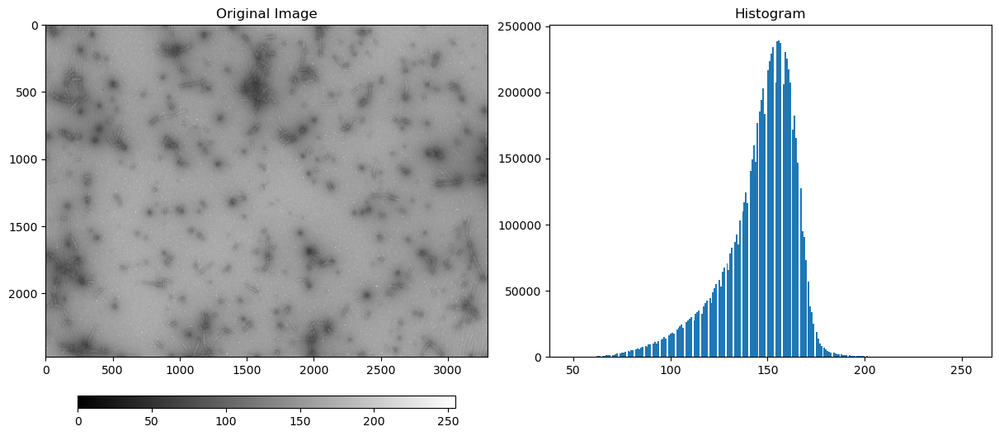

In [7]:
distributions = []
for img in images:
    f, arr = plt.subplots(1, 2, figsize=(12, 6), layout='compressed')
    ax1 = arr[0].imshow(img, cmap='gray', vmin=0.0, vmax=255.0)
    ax2 = arr[1].hist(img.ravel(), bins=256)
    arr[0].set_title('Original Image')
    arr[1].set_title('Histogram')
    plt.colorbar(ax1, ax=arr[0], aspect=30, orientation='horizontal', fraction=0.038)
    plt.show()

Synthetic image

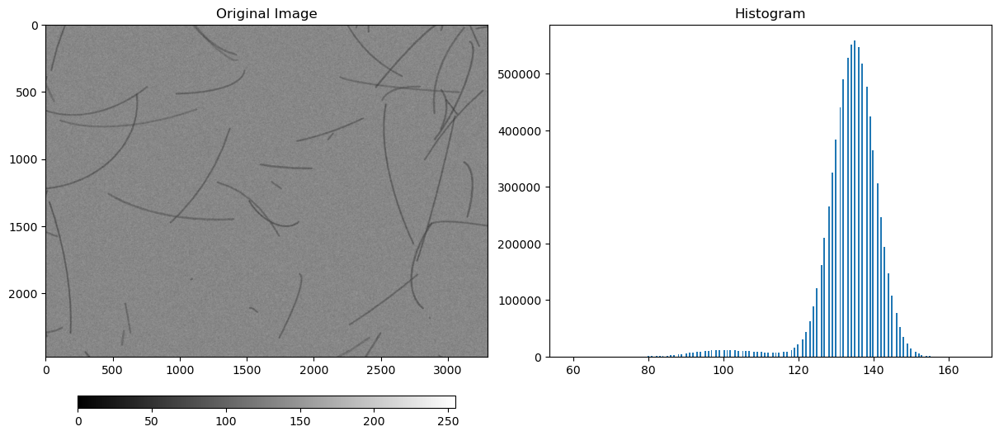

In [8]:
syn_img = cv.imread('../data/images/image_0.png', cv.IMREAD_UNCHANGED).astype(np.float64)
f, arr = plt.subplots(1, 2, figsize=(12, 6), layout='compressed')
ax1 = arr[0].imshow(syn_img, cmap='gray', vmin=0.0, vmax=255.0)
ax2 = arr[1].hist(syn_img.ravel(), bins=256)
arr[0].set_title('Original Image')
arr[1].set_title('Histogram')
plt.colorbar(ax1, ax=arr[0], aspect=30, orientation='horizontal', fraction=0.038)
plt.show()

# Getting SNR of all images.

In [9]:
def get_region(im, x=0, y=0, w=500, h=500, color=(0, 255, 0)):
    hl = im.copy()
    cv.rectangle(hl, (x, y), (x+w, y+h), color, thickness=10)
    return hl, im[y: y + h, x: x + w, 0]

def get_snr(im, threshold = 70, sensitivity=30, **kwargs):
    img1 = np.stack((im,)*3, axis=-1).astype(np.uint8)
    imhl, bg = get_region(img1, **kwargs)
    imsn = img1.copy()

    bg_mean = np.mean(bg)
    bg_std = np.std(bg)

    img2 = ((~img1.copy()).astype(np.float64) - abs(255 - bg_mean)).clip(min=0, max=255).astype(np.uint8)

    sn_mean = np.mean(img2[:,:,0][img2[:,:,0] > threshold])
    upper, lower = sn_mean + sensitivity, sn_mean - sensitivity
    mask = (img2[:,:,0] < upper).astype(bool) & (img2[:,:,0] > lower).astype(bool)
    imhl[mask] = [255, 0, 0]

    signal_mean = np.mean(img1[mask, 0])

    # SNR formula
    snr = abs(signal_mean - bg_mean) / bg_std

    plot_images([imsn], [imhl], 'Sampled Regions', f'SNR: {snr:.2f}\n              '
                                                f'{(20 * np.log10(snr)):.1f} dB', 'Original Image')

    return snr, bg_mean, bg_std, signal_mean

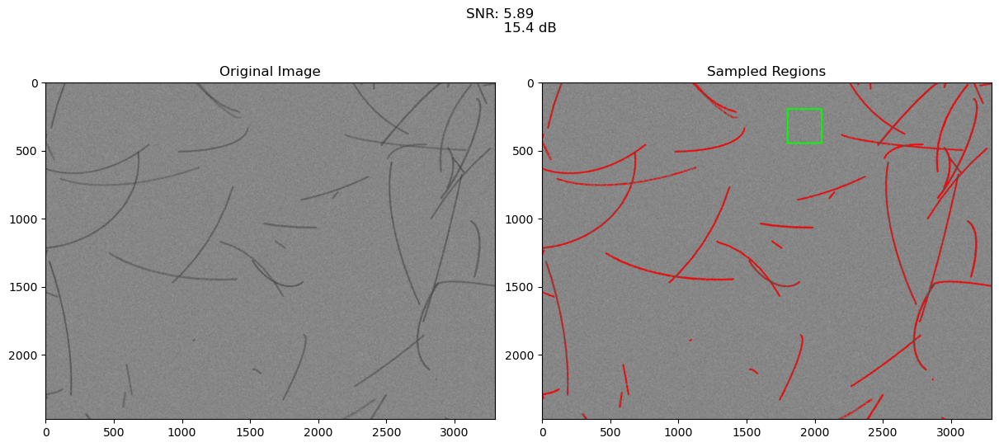

Background mean: 134.817776
Background std: 5.557765955293908
Signal mean: 102.08482546938446


In [10]:
# Synthetic image
syn_img = cv.imread('../data/images/image_0.png', cv.IMREAD_UNCHANGED).astype(np.float64)
_, bg_mean, bg_std, sn_mean = get_snr(syn_img, 15, 10, x=1800, y=200, w=250, h=250)
print(f"Background mean: {bg_mean}\nBackground std: {bg_std}\nSignal mean: {sn_mean}")

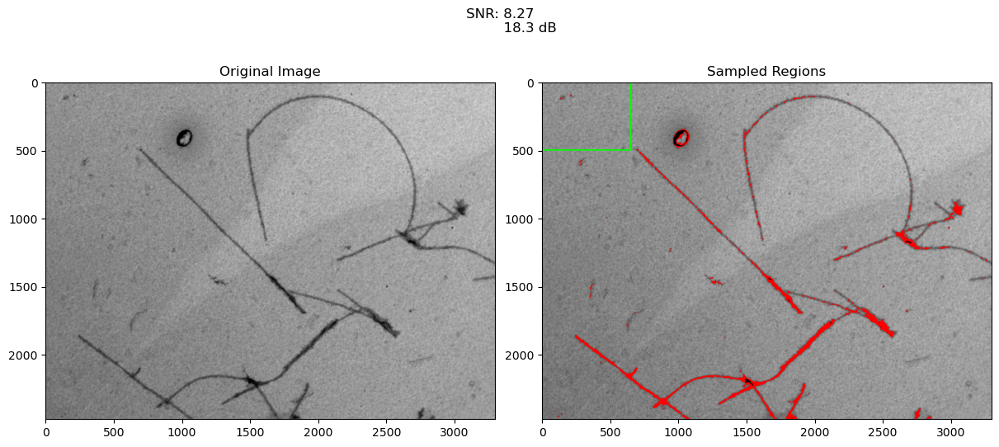

Background mean: 143.95172615384615
Background std: 9.372678729096311
Signal mean: 66.47004564542632


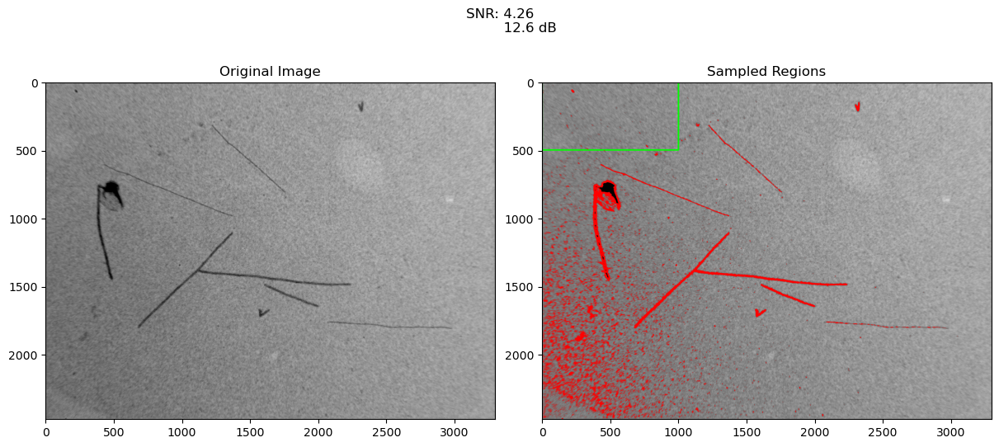

Background mean: 136.07595
Background std: 9.909684031163657
Signal mean: 93.82377877112611


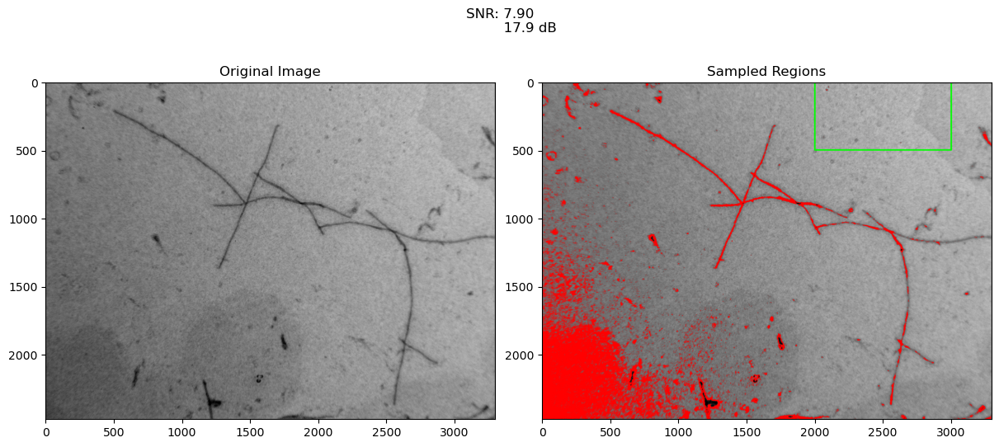

Background mean: 170.58682
Background std: 10.753602851491216
Signal mean: 85.66695196969529


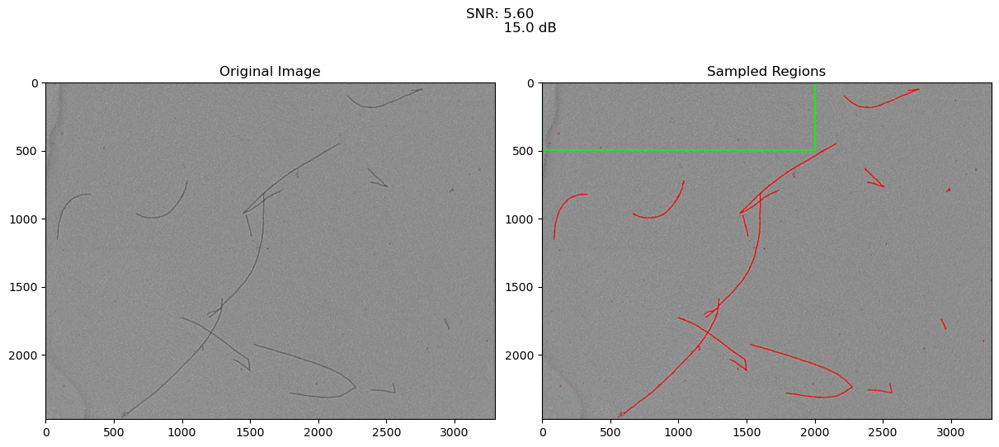

Background mean: 141.270105
Background std: 7.376742796720989
Signal mean: 99.92360578046257


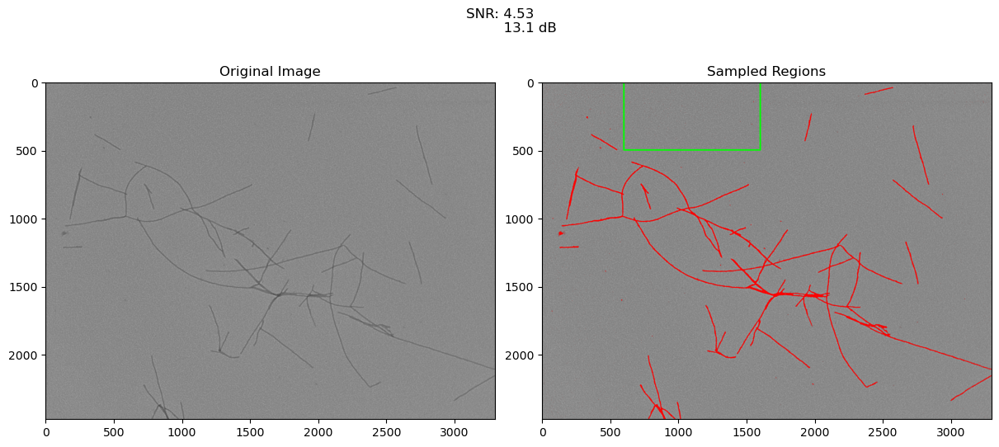

Background mean: 135.52405
Background std: 5.658938910917842
Signal mean: 109.91305299644257


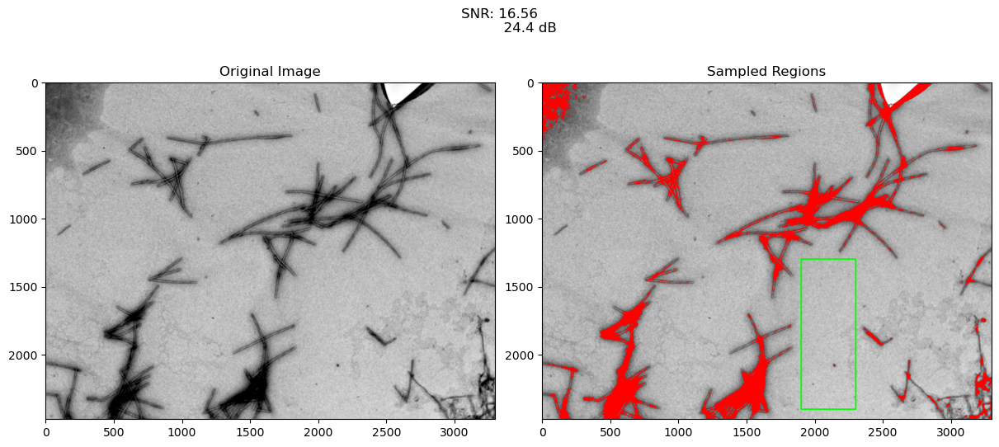

Background mean: 192.74527727272726
Background std: 8.79818849978024
Signal mean: 47.06009206537011


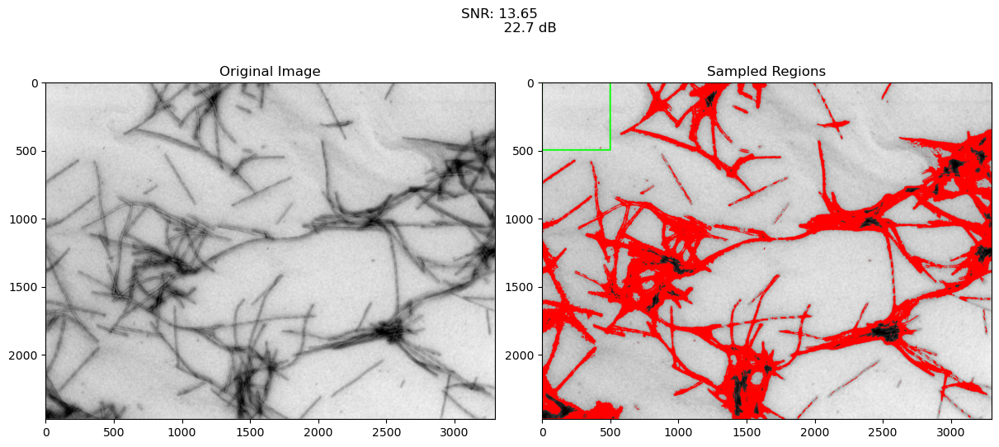

Background mean: 218.371444
Background std: 6.95334058959174
Signal mean: 123.4816401742561


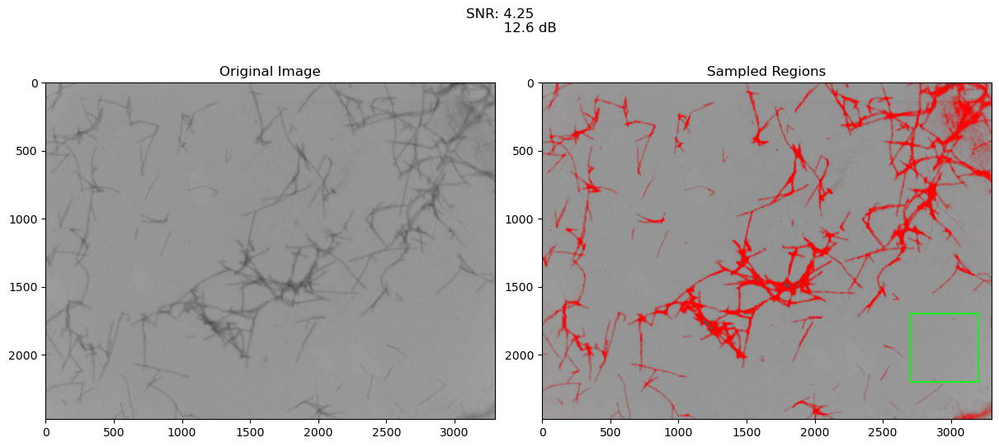

Background mean: 152.283848
Background std: 7.166509213898773
Signal mean: 121.79533431024748


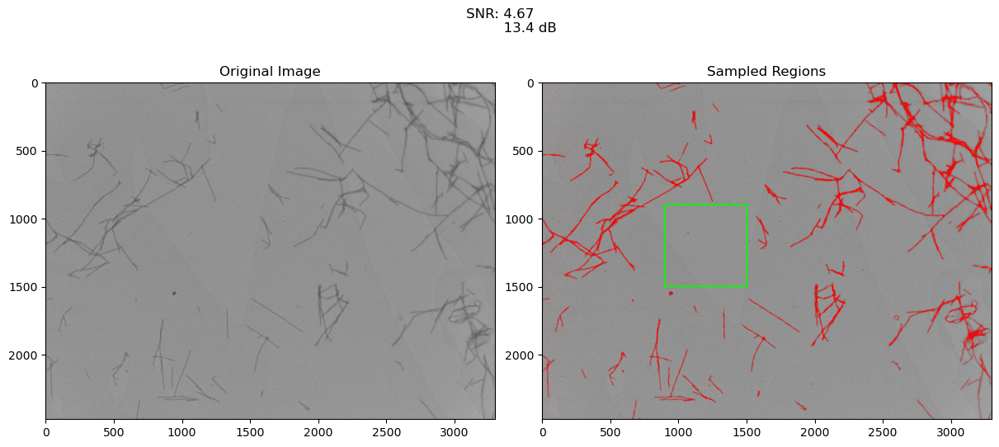

Background mean: 145.47530833333334
Background std: 5.989149103859736
Signal mean: 117.52964452988235


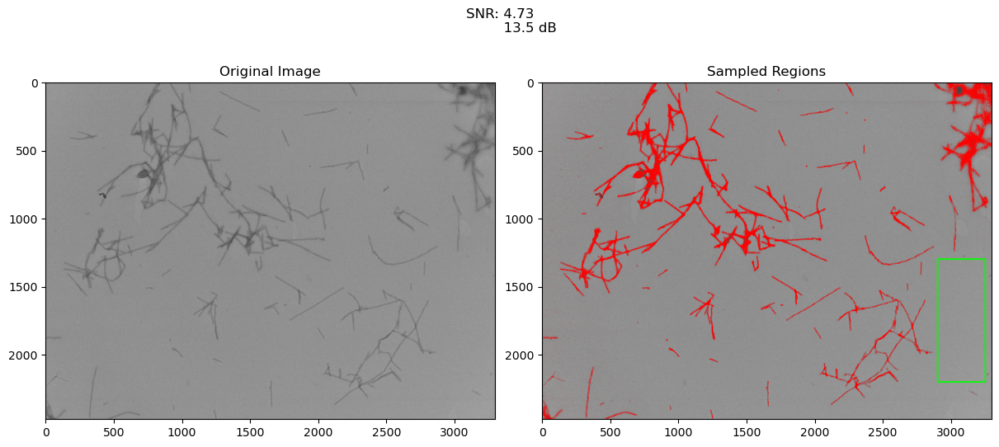

Background mean: 148.88228253968254
Background std: 7.075273267223366
Signal mean: 115.42010006108674


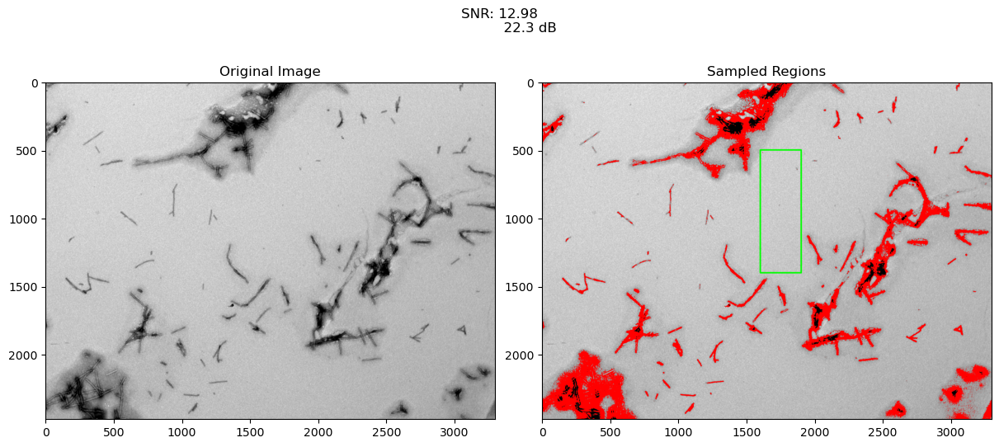

Background mean: 203.04793703703703
Background std: 7.6142236663024345
Signal mean: 104.17933273169714


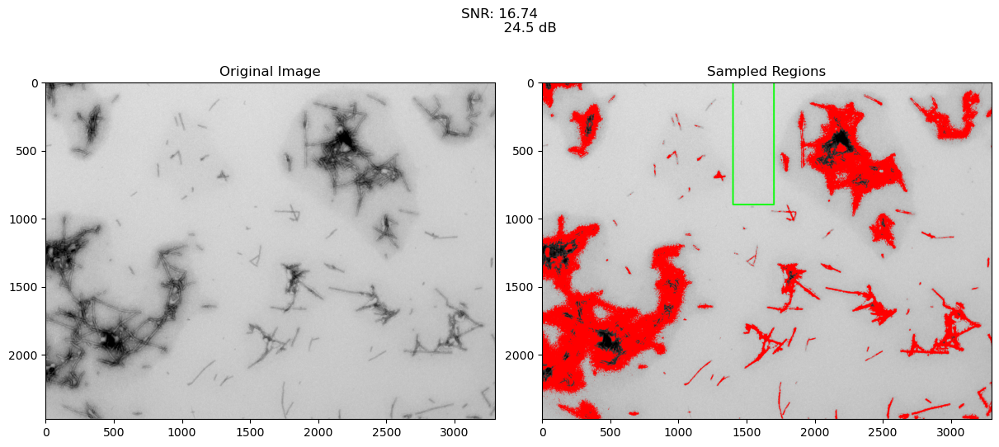

Background mean: 215.64614074074075
Background std: 4.8375749888538815
Signal mean: 134.6602252438808


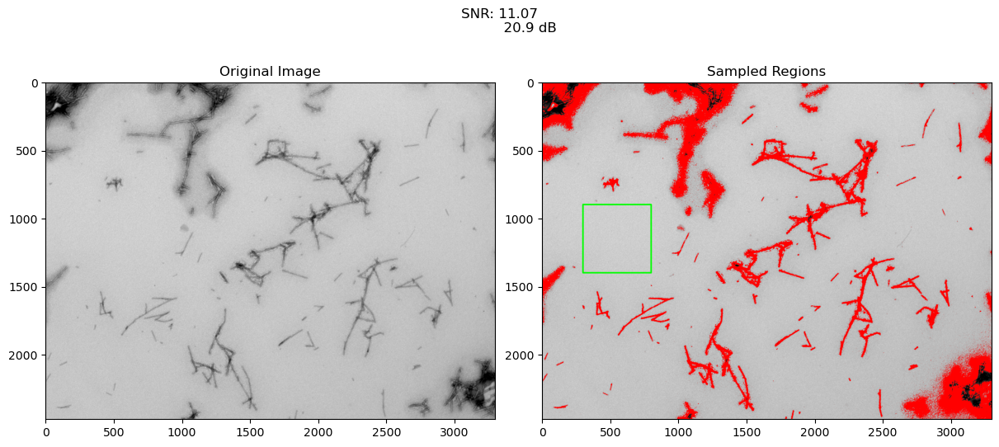

Background mean: 205.465864
Background std: 6.274994401073518
Signal mean: 136.0005846215658


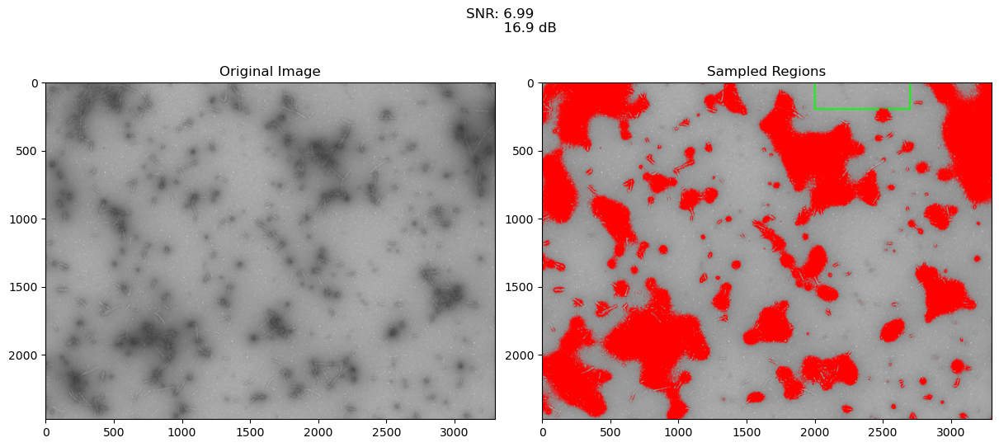

Background mean: 162.43227142857143
Background std: 6.349299060124507
Signal mean: 118.02937198218233


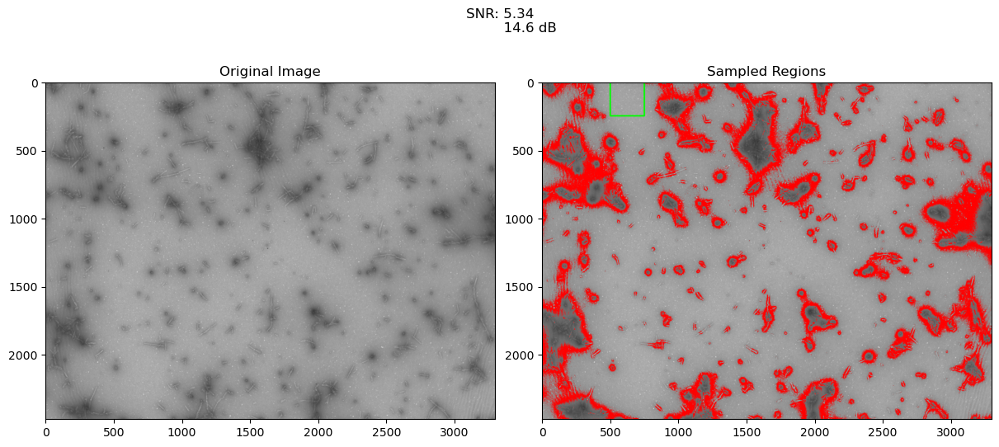

Background mean: 161.998544
Background std: 6.139812202344955
Signal mean: 129.20951496967533


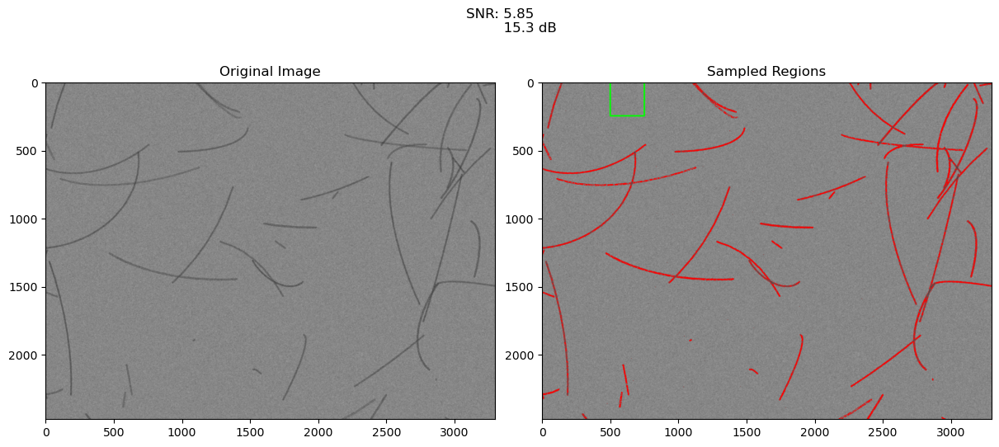

Background mean: 134.712432
Background std: 5.573090403481357
Signal mean: 102.08482546938446


In [11]:
# Image 1
_, bg_mean, bg_std, sn_mean = get_snr(images[0], 70, 40, x=0, y=0, w=650, h=500)
print(f"Background mean: {bg_mean}\nBackground std: {bg_std}\nSignal mean: {sn_mean}")
# Image 2
_, bg_mean, bg_std, sn_mean = get_snr(images[1], 45, 45, x=0, y=0, w=1000, h=500)
print(f"Background mean: {bg_mean}\nBackground std: {bg_std}\nSignal mean: {sn_mean}")
# Image 3
_, bg_mean, bg_std, sn_mean = get_snr(images[2], 90, 30, x=2000, y=0, w=1000, h=500)
print(f"Background mean: {bg_mean}\nBackground std: {bg_std}\nSignal mean: {sn_mean}")
# Image 4
_, bg_mean, bg_std, sn_mean = get_snr(images[3], 60, 40, x=0, y=0, w=2000, h=500)
print(f"Background mean: {bg_mean}\nBackground std: {bg_std}\nSignal mean: {sn_mean}")
# Image 5
_, bg_mean, bg_std, sn_mean = get_snr(images[4], 50, 40, x=600, y=0, w=1000, h=500)
print(f"Background mean: {bg_mean}\nBackground std: {bg_std}\nSignal mean: {sn_mean}")
# Image 6
_, bg_mean, bg_std, sn_mean = get_snr(images[5], 150, 70, x=1900, y=1300, w=400, h=1100)
print(f"Background mean: {bg_mean}\nBackground std: {bg_std}\nSignal mean: {sn_mean}")
# Image 7
_, bg_mean, bg_std, sn_mean = get_snr(images[6], 70, 50, x=0, y=0, w=500, h=500)
print(f"Background mean: {bg_mean}\nBackground std: {bg_std}\nSignal mean: {sn_mean}")
# Image 8
_, bg_mean, bg_std, sn_mean = get_snr(images[7], 30, 20, x=2700, y=1700, w=500, h=500)
print(f"Background mean: {bg_mean}\nBackground std: {bg_std}\nSignal mean: {sn_mean}")
# Image 9
_, bg_mean, bg_std, sn_mean = get_snr(images[8], 25, 15, x=900, y=900, w=600, h=600)
print(f"Background mean: {bg_mean}\nBackground std: {bg_std}\nSignal mean: {sn_mean}")
# Image 10
_, bg_mean, bg_std, sn_mean = get_snr(images[9], 30, 20, x=2900, y=1300, w=350, h=900)
print(f"Background mean: {bg_mean}\nBackground std: {bg_std}\nSignal mean: {sn_mean}")
# Image 11
_, bg_mean, bg_std, sn_mean = get_snr(images[10], 70, 60, x=1600, y=500, w=300, h=900)
print(f"Background mean: {bg_mean}\nBackground std: {bg_std}\nSignal mean: {sn_mean}")
# Image 12
_, bg_mean, bg_std, sn_mean = get_snr(images[11], 50, 50, x=1400, y=0, w=300, h=900)
print(f"Background mean: {bg_mean}\nBackground std: {bg_std}\nSignal mean: {sn_mean}")
# Image 13
_, bg_mean, bg_std, sn_mean = get_snr(images[12], 50, 60, x=300, y=900, w=500, h=500)
print(f"Background mean: {bg_mean}\nBackground std: {bg_std}\nSignal mean: {sn_mean}")
# Image 14
_, bg_mean, bg_std, sn_mean = get_snr(images[13], 50, 40, x=2000, y=0, w=700, h=200)
print(f"Background mean: {bg_mean}\nBackground std: {bg_std}\nSignal mean: {sn_mean}")
# Image 15
_, bg_mean, bg_std, sn_mean = get_snr(images[14], 15, 10, x=500, y=0, w=250, h=250)
print(f"Background mean: {bg_mean}\nBackground std: {bg_std}\nSignal mean: {sn_mean}")

# Synthetic image
_, bg_mean, bg_std, sn_mean = get_snr(syn_img, 15, 10, x=500, y=0, w=250, h=250)
print(f"Background mean: {bg_mean}\nBackground std: {bg_std}\nSignal mean: {sn_mean}")

# Example: Cropping images into overlapping windows.

Horizontal Windows: 2.0
Vertical Windows: 2.0
------------
Horizontal Overlap: 704.0
Vertical Overlap: 728.0
------------
Stride: X = 1296, Y = 872


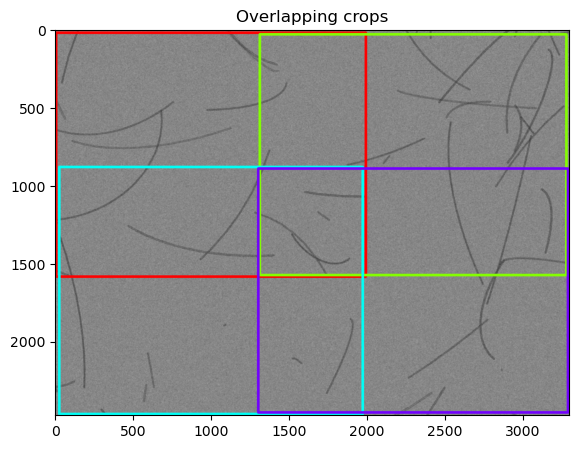

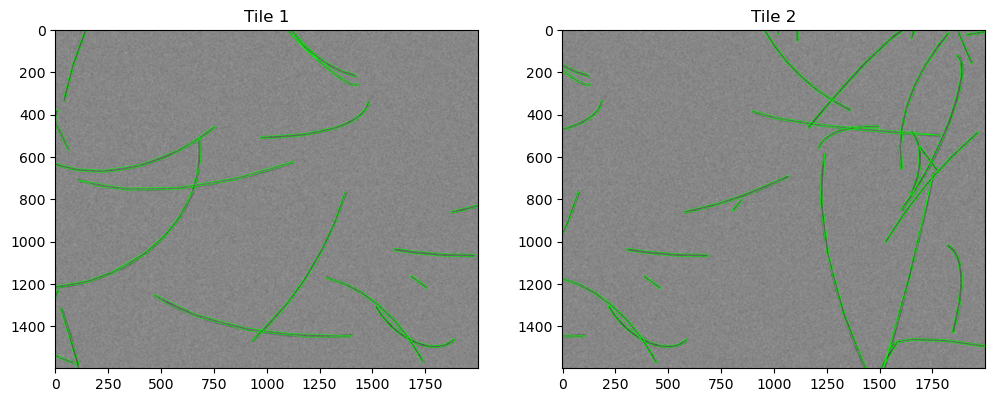

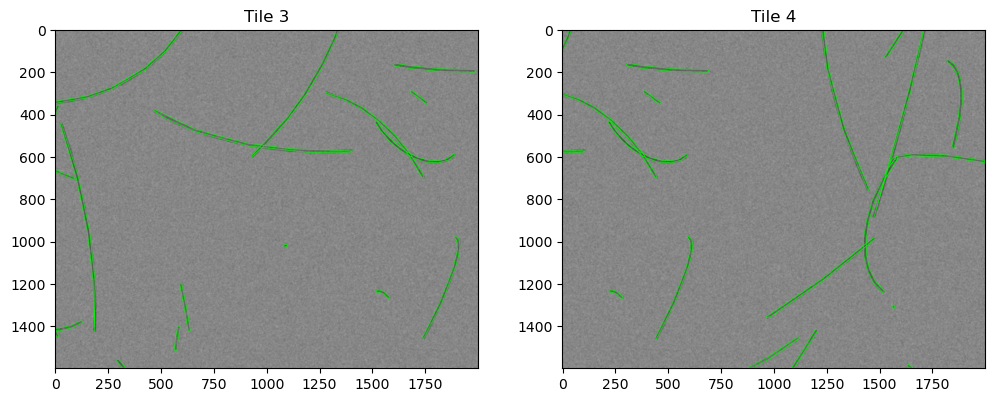

In [12]:
from src.tiling import tile_image
from matplotlib import colormaps

image = cv.imread("../data/images/image_0.png")
img_h, img_w = image.shape[:2]
annots = []
with open("../data/images/image_0.txt", "r") as f:
    for line in f:
        parts = line.strip().split()
        class_id = parts[0]
        points = [(int(float(parts[i]) * img_w), int(float(parts[i+1]) * img_h)) for i in range(1, len(parts), 2)]
        annots.append((class_id, points))

# CREATING TILES
tiles, boxes = tile_image(image, annots, size=(1600, 2000), min_overlap=400, verbose=1)

# Plot tile positions
im = image.copy()
cmap = colormaps['hsv']
for i, box in enumerate(boxes):
    cv.rectangle(im,
                 pt1=(box[1]+7+(10*(i%3)), box[0]+7+(10*((i+1)%3))),
                 pt2=(box[3]-7-(10*(i%3)), box[2]-7-(10*((1+i)%3))),
                 color=255*np.array(cmap(i/len(boxes))), thickness=15)
fig, ax = plt.subplots(figsize=(12, 5))
ax.set_title('Overlapping crops')
ax.imshow(im)
plt.show()

# Plot tiles
for i in range(0, len(tiles), 2):
    tile_img, annotations = tiles[i]
    tile_im2, annotations2 = tiles[i+1]
    img = tile_img.copy()
    img2 = tile_im2.copy()

    # Draw each polygon
    for _, polygon in annotations:  # Each annotation is a list of (xi, yi) tuples
        pts = np.array(polygon, np.int32).reshape((-1, 1, 2))
        cv.polylines(img, [pts], isClosed=True, color=(0, 255, 0), thickness=2)
    for _, polygon in annotations2:  # Each annotation is a list of (xi, yi) tuples
        pts = np.array(polygon, np.int32).reshape((-1, 1, 2))
        cv.polylines(img2, [pts], isClosed=True, color=(0, 255, 0), thickness=2)

    # Display image
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))
    ax[0].imshow(img)
    ax[0].set_title(f'Tile {i + 1}')
    ax[1].imshow(img2)
    ax[1].set_title(f'Tile {i + 2}')
    plt.show()

# End.